<a href="https://colab.research.google.com/github/mrshamshir/WGAN-for-human-face-generation/blob/main/WGAN_for_face_generation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# importing the libraries
import torch, torchvision, os, PIL, pdb
from torch import nn
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.utils import make_grid
from tqdm.auto import tqdm
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt


In [ ]:
def show(tensor, num=25, wandbactive=0, name=''):
  data = tensor.detach().cpu()
  grid = make_grid(data[:num], nrow=5).permute(1,2,0)

  ## optional
  if (wandbactive==1):
    wandb.log({name:wandb.Image(grid.numpy().clip(0,1))})

  plt.imshow(grid.clip(0,1))
  plt.show()

In [ ]:
### hyperparameters and general parameters
n_epochs=50
batch_size=128
lr=1e-4
z_dim=200
device='cuda' #GPU

cur_step=0
crit_cycles=5
gen_losses=[]
crit_losses=[]
show_step=80
save_step=80

wandbact=1 # yes, we want to track stats through weights and biases, optional

In [ ]:
#### optional
!pip install wandb -qqq
import wandb
wandb.login(key='aec60f3a7953ced265a0065b116ad01846b483fe')  #instructions are in the related video :)
# wandb.login(key='PUT HERE YOUR WANDB KEY')  #instructions are in the related video :)

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 12.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.4/196.4 kB 17.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 254.1/254.1 kB 22.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 6.6 MB/s eta 0:00:00


wandb: W&B API key is configured. Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

In [ ]:
%%capture
experiment_name = wandb.util.generate_id()

myrun=wandb.init(
    project="wgan",
    group=experiment_name,
    config={
        "optimizer":"adam",
        "model":"wgan gp",
        "epoch":"1000",
        "batch_size":128
    }
)

config=wandb.config

## Sometimes this call to the wandb service may fail or give problems.
## If needed, you can use the Runtime->Restart Runtime option in the menus
## to restart and try again. If you keep having issues, you may set wandbact=0
## to skip temporarily the remote stats. You would also
## need to set wandbactive to 0 within the training loop in
## show(fake, wandbactive=0, name='fake') and show(real, wandbactive=0, name='real').
## However, in general this should work with no problems (try a few times if you have issues)

In [ ]:
# generator model
# https://medium.com/@ideami

class Generator(nn.Module):
  def __init__(self, z_dim=64, d_dim=16):
    super(Generator, self).__init__()
    self.z_dim=z_dim

    self.gen = nn.Sequential(
            ## ConvTranspose2d: in_channels, out_channels, kernel_size, stride=1, padding=0
            ## Calculating new width and height: (n-1)*stride -2*padding +ks
            ## n = width or height
            ## ks = kernel size
            ## we begin with a 1x1 image with z_dim number of channels (200)
            nn.ConvTranspose2d(z_dim, d_dim * 32, 4, 1, 0), ## 4x4 (ch: 200, 512)
            nn.BatchNorm2d(d_dim*32),
            nn.ReLU(True),

            nn.ConvTranspose2d(d_dim*32, d_dim*16, 4, 2, 1), ## 8x8 (ch: 512, 256)
            nn.BatchNorm2d(d_dim*16),
            nn.ReLU(True),

            nn.ConvTranspose2d(d_dim*16, d_dim*8, 4, 2, 1), ## 16x16 (ch: 256, 128)
            #(n-1)*stride -2*padding +ks = (8-1)*2-2*1+4=16
            nn.BatchNorm2d(d_dim*8),
            nn.ReLU(True),

            nn.ConvTranspose2d(d_dim*8, d_dim*4, 4, 2, 1), ## 32x32 (ch: 128, 64)
            nn.BatchNorm2d(d_dim*4),
            nn.ReLU(True),

            nn.ConvTranspose2d(d_dim*4, d_dim*2, 4, 2, 1), ## 64x64 (ch: 64, 32)
            nn.BatchNorm2d(d_dim*2),
            nn.ReLU(True),

            nn.ConvTranspose2d(d_dim*2, 3, 4, 2, 1), ## 128x128 (ch: 32, 3)
            nn.Tanh() ### produce result in the range from -1 to 1
    )


  def forward(self, noise):
    x=noise.view(len(noise), self.z_dim, 1, 1)  # 128 x 200 x 1 x 1
    return self.gen(x)


def gen_noise(num, z_dim, device='cuda'):
   return torch.randn(num, z_dim, device=device) # 128 x 200



In [ ]:
## critic model

class Critic(nn.Module):
  def __init__(self, d_dim=16):
    super(Critic, self).__init__()

    self.crit = nn.Sequential(
      # Conv2d: in_channels, out_channels, kernel_size, stride=1, padding=0
      ## New width and height: # (n+2*pad-ks)//stride +1
      nn.Conv2d(3, d_dim, 4, 2, 1), #(n+2*pad-ks)//stride +1 = (128+2*1-4)//2+1=64x64 (ch: 3,16)
      nn.InstanceNorm2d(d_dim),
      nn.LeakyReLU(0.2),

      nn.Conv2d(d_dim, d_dim*2, 4, 2, 1), ## 32x32 (ch: 16, 32)
      nn.InstanceNorm2d(d_dim*2),
      nn.LeakyReLU(0.2),

      nn.Conv2d(d_dim*2, d_dim*4, 4, 2, 1), ## 16x16 (ch: 32, 64)
      nn.InstanceNorm2d(d_dim*4),
      nn.LeakyReLU(0.2),

      nn.Conv2d(d_dim*4, d_dim*8, 4, 2, 1), ## 8x8 (ch: 64, 128)
      nn.InstanceNorm2d(d_dim*8),
      nn.LeakyReLU(0.2),

      nn.Conv2d(d_dim*8, d_dim*16, 4, 2, 1), ## 4x4 (ch: 128, 256)
      nn.InstanceNorm2d(d_dim*16),
      nn.LeakyReLU(0.2),

      nn.Conv2d(d_dim*16, 1, 4, 1, 0), #(n+2*pad-ks)//stride +1=(4+2*0-4)//1+1= 1X1 (ch: 256,1)

    )


  def forward(self, image):
    # image: 128 x 3 x 128 x 128
    crit_pred = self.crit(image) # 128 x 1 x 1 x 1
    return crit_pred.view(len(crit_pred),-1) ## 128 x 1


In [ ]:
## optional, init your weights in different ways
def init_weights(m):
    if isinstance(m, nn.Conv2d) or isinstance(m,nn.ConvTranspose2d):
      torch.nn.init.normal_(m.weight, 0.0, 0.02)
      torch.nn.init.constant_(m.bias,0)

    if isinstance(m,nn.BatchNorm2d):
      torch.nn.init.normal_(m.weight, 0.0, 0.02)
      torch.nn.init.constant_(m.bias,0)


##gen=gen.apply(init_weights)
##crit=crit.apply(init_weights)




In [ ]:
# load dataset
import gdown, zipfile

url = 'https://drive.google.com/uc?id=0B7EVK8r0v71pZjFTYXZWM3FlRnM'
path='data/celeba'
download_path=f'{path}/img_align_celeba.zip'

if not os.path.exists(path):
  os.makedirs(path)

gdown.download(url, download_path, quiet=False)

with zipfile.ZipFile(download_path, 'r') as ziphandler:
  ziphandler.extractall(path)


#### Alternative download address:
# Celebra gdrive: https://drive.google.com/drive/folders/0B7EVK8r0v71pTUZsaXdaSnZBZzg?resourcekey=0-rJlzl934LzC-Xp28GeIBzQ
# Kaggle: https://www.kaggle.com/jessicali9530/celeba-dataset


Downloading...
From (original): https://drive.google.com/uc?id=0B7EVK8r0v71pZjFTYXZWM3FlRnM
From (redirected): https://drive.google.com/uc?id=0B7EVK8r0v71pZjFTYXZWM3FlRnM&confirm=t&uuid=6a0781c3-79ed-4190-a194-a0717528dc5b
To: /content/data/celeba/img_align_celeba.zip
100%|██████████| 1.44G/1.44G [00:11<00:00, 125MB/s]


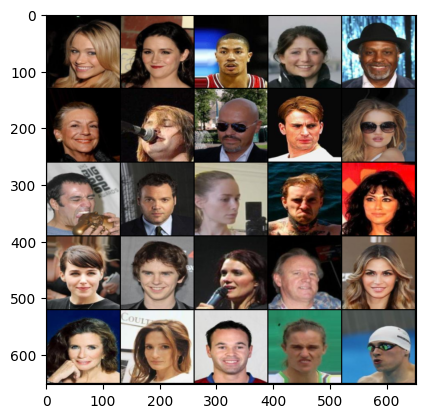

In [ ]:
### Dataset, DataLoader, declare gen,crit, test dataset

class Dataset(Dataset):
  def __init__(self, path, size=128, lim=10000):
    self.sizes=[size, size]
    items, labels=[],[]

    for data in os.listdir(path)[:lim]:
      #path: './data/celeba/img_align_celeba'
      #data: '114568.jpg
      item = os.path.join(path,data)
      items.append(item)
      labels.append(data)
    self.items=items
    self.labels=labels


  def __len__(self):
    return len(self.items)

  def __getitem__(self,idx):
    data = PIL.Image.open(self.items[idx]).convert('RGB') # (178,218)
    data = np.asarray(torchvision.transforms.Resize(self.sizes)(data)) # 128 x 128 x 3
    data = np.transpose(data, (2,0,1)).astype(np.float32, copy=False) # 3 x 128 x 128 # from 0 to 255
    data = torch.from_numpy(data).div(255) # from 0 to 1
    return data, self.labels[idx]

## Dataset
data_path='./data/celeba/img_align_celeba'
ds = Dataset(data_path, size=128, lim=10000)

## DataLoader
dataloader = DataLoader(ds, batch_size=batch_size, shuffle=True)

## Models
gen = Generator(z_dim).to(device)
crit = Critic().to(device)

## Optimizers
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(0.5,0.9))
crit_opt= torch.optim.Adam(crit.parameters(), lr=lr, betas=(0.5,0.9))

## Initializations
# gen=gen.apply(init_weights)
# crit=crit.apply(init_weights)

#wandb optional
if (wandbact==1):
  wandb.watch(gen, log_freq=100)
  wandb.watch(crit, log_freq=100)

x,y=next(iter(dataloader))
show(x)


In [ ]:
## gradient penalty calculation

def get_gp(real, fake, crit, alpha, gamma=10):
  mix_images = real * alpha + fake * (1-alpha) # 128 x 3 x 128 x 128
  mix_scores = crit(mix_images) # 128 x 1

  gradient = torch.autograd.grad(
      inputs = mix_images,
      outputs = mix_scores,
      grad_outputs=torch.ones_like(mix_scores),
      retain_graph=True,
      create_graph=True,
  )[0] # 128 x 3 x 128 x 128

  gradient = gradient.view(len(gradient), -1)   # 128 x 49152
  gradient_norm = gradient.norm(2, dim=1)
  gp = gamma * ((gradient_norm-1)**2).mean()

  return gp



In [ ]:
## Save and load checkpoints

root_path='/content/drive/MyDrive/output/exp1_ep50_10k/'

def save_checkpoint(name):
  torch.save({
      'epoch': epoch,
      'model_state_dict': gen.state_dict(),
      'optimizer_state_dict': gen_opt.state_dict()
  }, f"{root_path}G_{name}.pkl")

  torch.save({
      'epoch': epoch,
      'model_state_dict': crit.state_dict(),
      'optimizer_state_dict': crit_opt.state_dict()
  }, f"{root_path}C_{name}.pkl")

  print("Saved checkpoint")

def load_checkpoint(name):
  checkpoint = torch.load(f"{root_path}G_{name}.pkl")
  gen.load_state_dict(checkpoint['model_state_dict'])
  gen_opt.load_state_dict(checkpoint['optimizer_state_dict'])

  checkpoint = torch.load(f"{root_path}C_{name}.pkl")
  crit.load_state_dict(checkpoint['model_state_dict'])
  crit_opt.load_state_dict(checkpoint['optimizer_state_dict'])

  print("Loaded checkpoint")

#load_checkpoint('final-wgan-noinit')

In [ ]:
#!cp C-final* ./data/
#!cp G-final* ./data/
#epoch=1
#save_checkpoint("test")
#load_checkpoint("test")

  0%|          | 0/79 [00:00<?, ?it/s]

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  80 80
Saved checkpoint


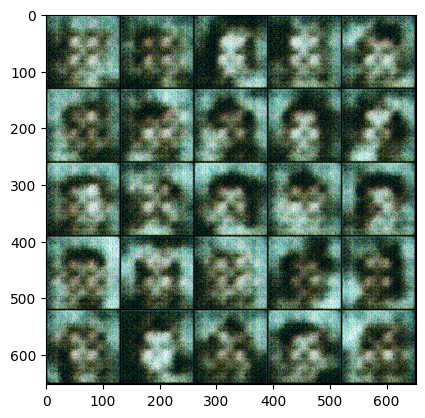

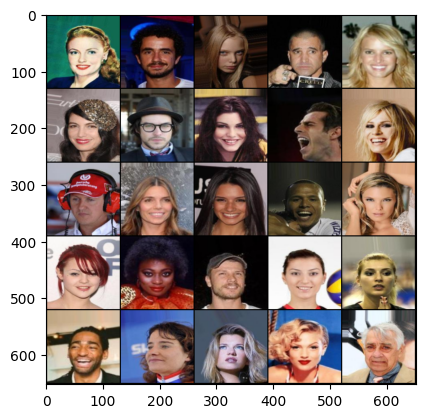

Epoch: 1: Step 80: Generator loss: 15.327117782086134, critic loss: -14.370161669552322


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  160 80
Saved checkpoint


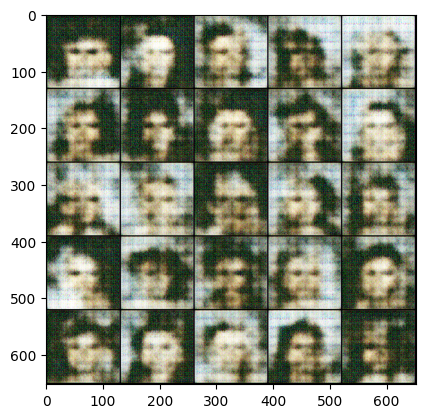

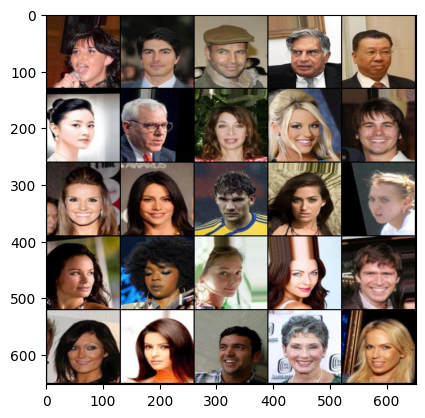

Epoch: 2: Step 160: Generator loss: 20.406443572044374, critic loss: -15.266195251941687


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  240 80
Saved checkpoint


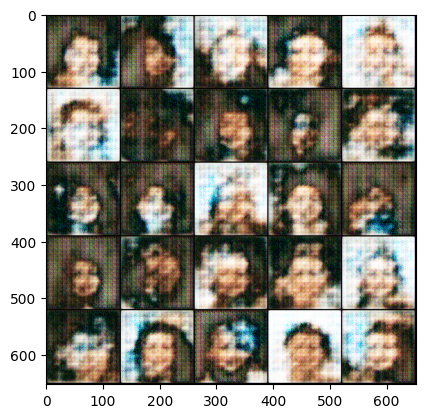

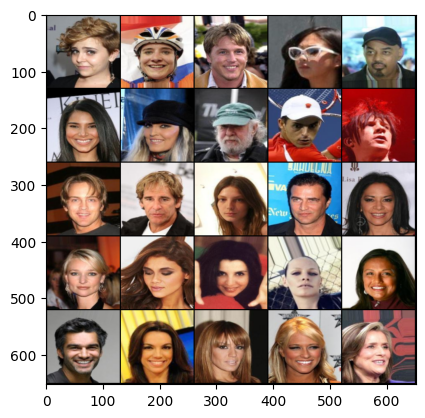

Epoch: 3: Step 240: Generator loss: 17.81832982301712, critic loss: -12.723261301517487


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  320 80
Saved checkpoint


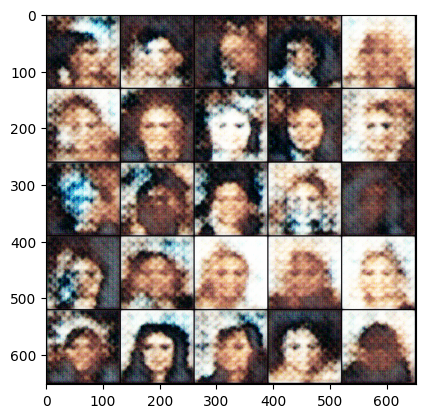

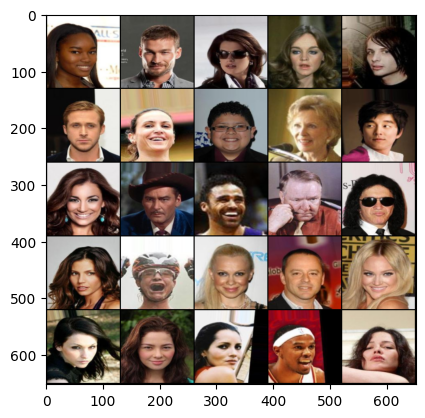

Epoch: 4: Step 320: Generator loss: 17.354126942157745, critic loss: -11.25389521420002


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  400 80
Saved checkpoint


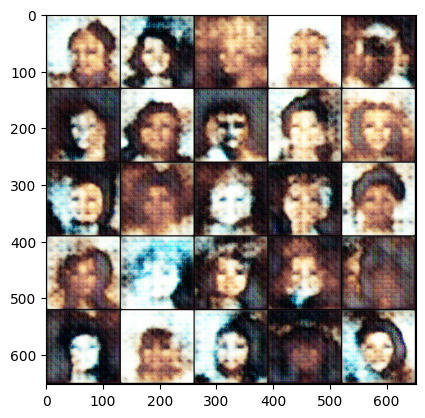

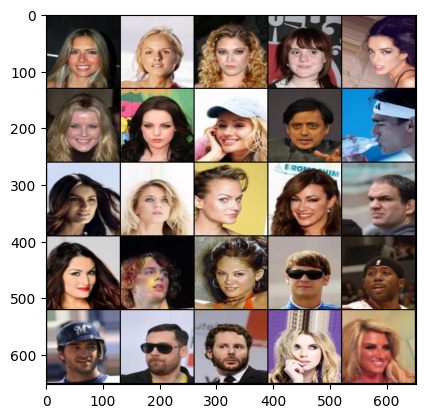

Epoch: 5: Step 400: Generator loss: 17.50050159692764, critic loss: -10.18873746275902


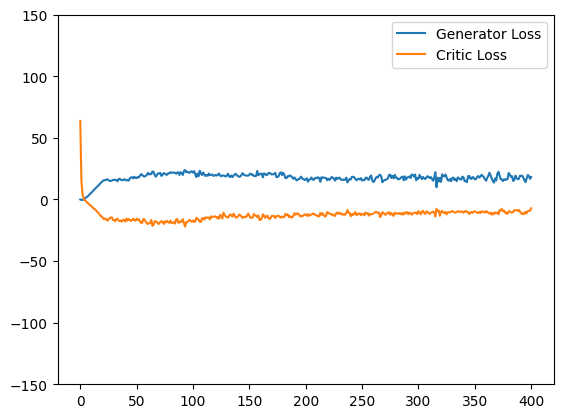

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  480 80
Saved checkpoint


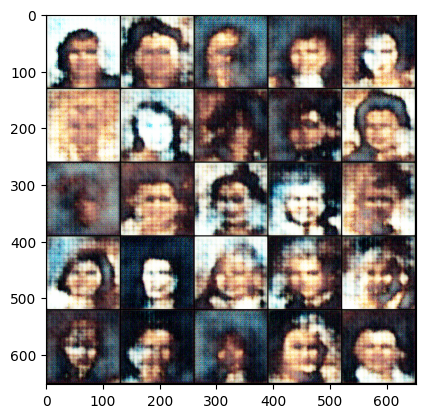

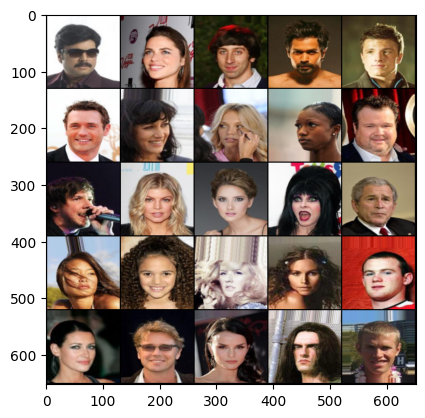

Epoch: 6: Step 480: Generator loss: 18.310959732532503, critic loss: -9.497222567796703


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  560 80
Saved checkpoint


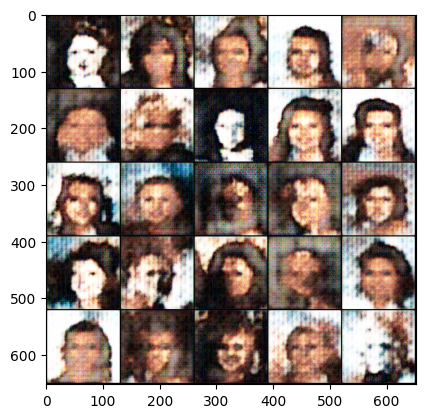

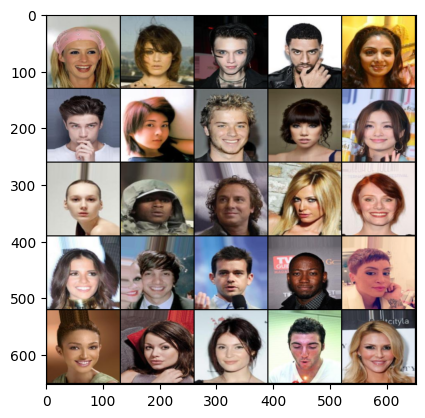

Epoch: 7: Step 560: Generator loss: 18.641220617294312, critic loss: -9.037567828893662


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  640 80
Saved checkpoint


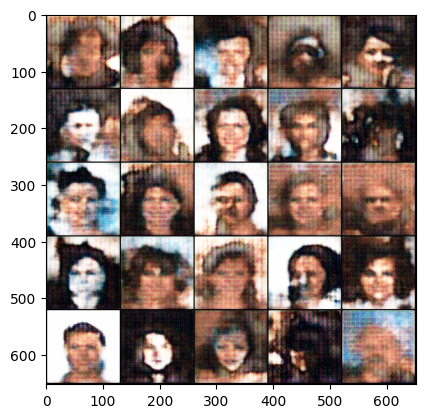

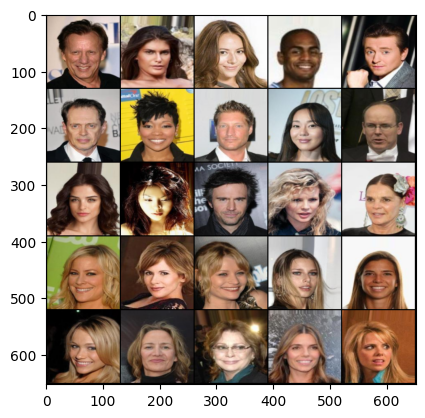

Epoch: 8: Step 640: Generator loss: 19.57026399374008, critic loss: -8.635608159303668


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  720 80
Saved checkpoint


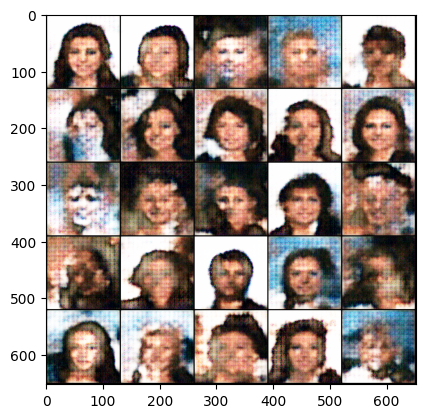

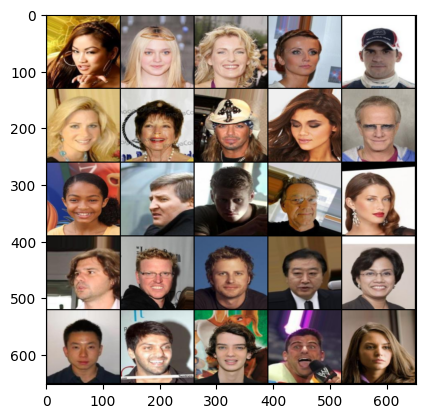

Epoch: 9: Step 720: Generator loss: 20.33769917488098, critic loss: -8.279931193590164


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  800 80
Saved checkpoint


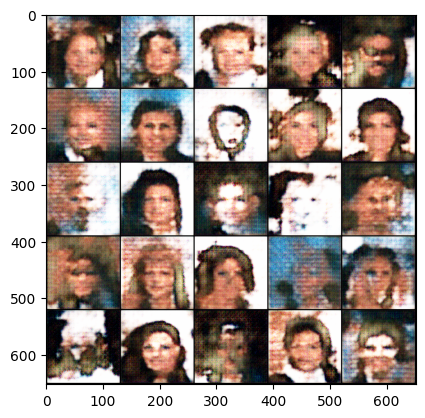

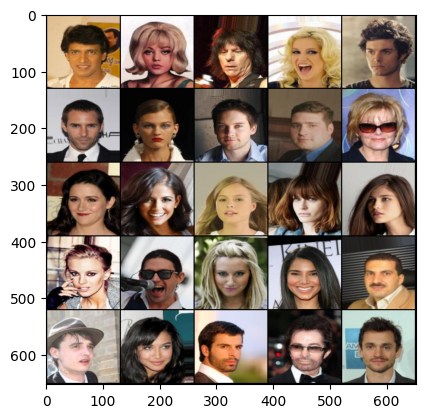

Epoch: 10: Step 800: Generator loss: 20.738009905815126, critic loss: -8.058989963531497


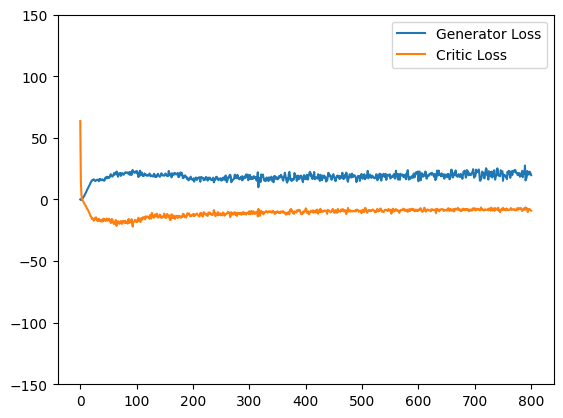

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  880 80
Saved checkpoint


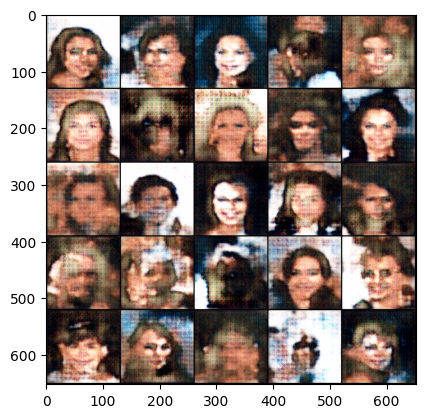

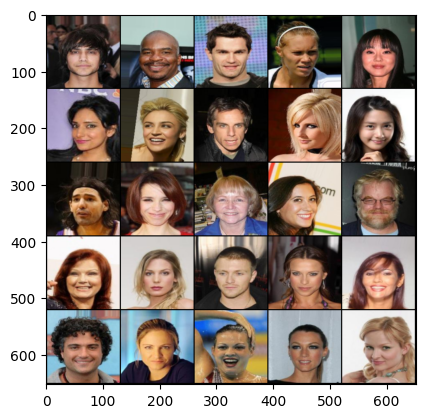

Epoch: 11: Step 880: Generator loss: 20.894839811325074, critic loss: -8.005580320358277


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  960 80
Saved checkpoint


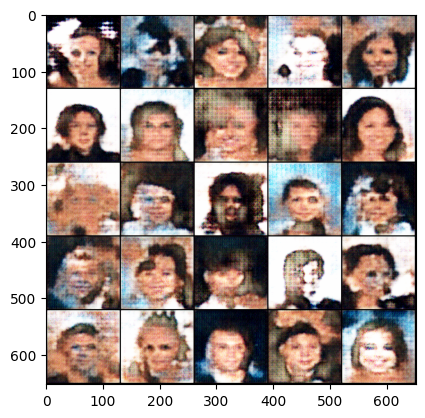

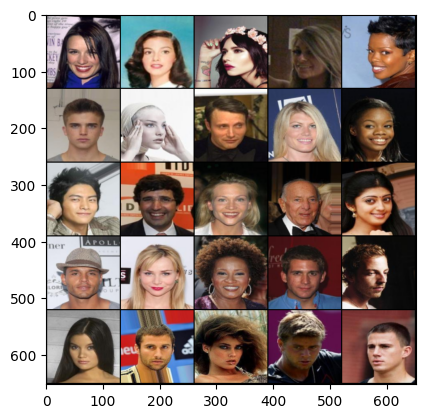

Epoch: 12: Step 960: Generator loss: 21.18383369445801, critic loss: -7.873038790822032


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1040 80
Saved checkpoint


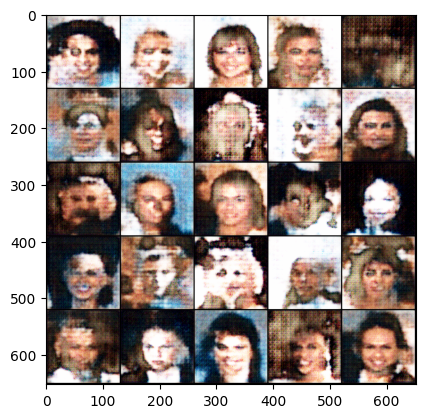

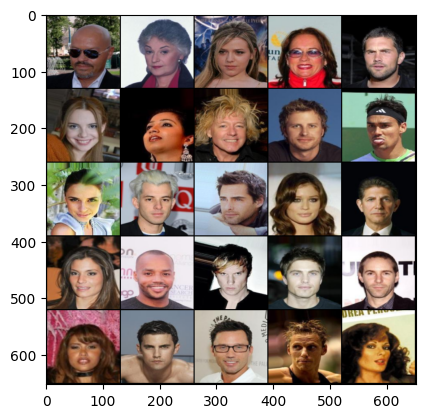

Epoch: 13: Step 1040: Generator loss: 20.711235547065733, critic loss: -7.589224184155467


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1120 80
Saved checkpoint


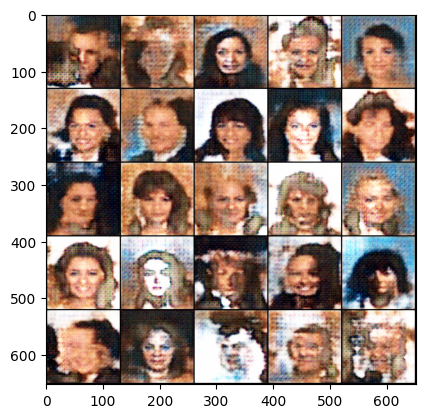

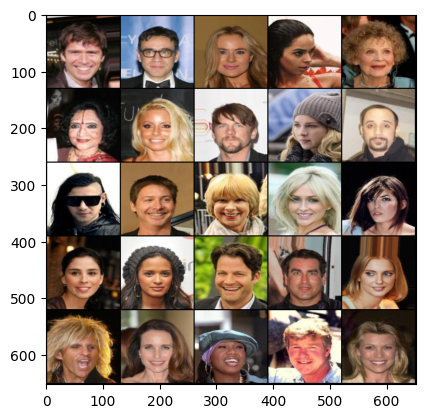

Epoch: 14: Step 1120: Generator loss: 20.621086764335633, critic loss: -7.5866441279649734


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1200 80
Saved checkpoint


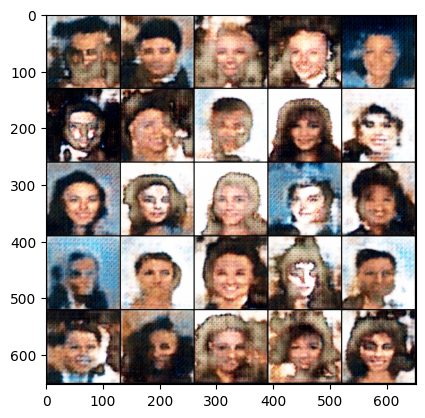

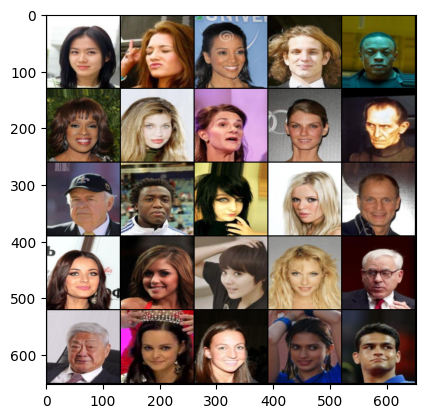

Epoch: 15: Step 1200: Generator loss: 20.769448244571684, critic loss: -7.489031713008879


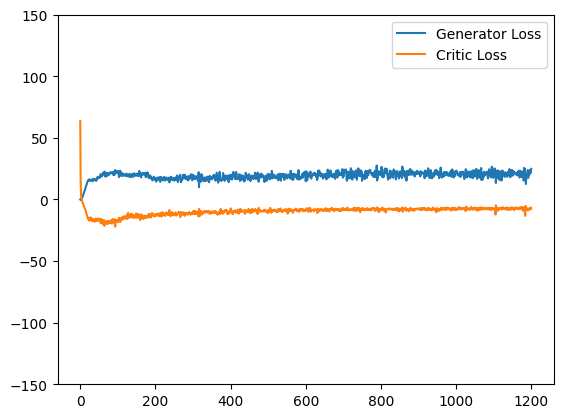

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1280 80
Saved checkpoint


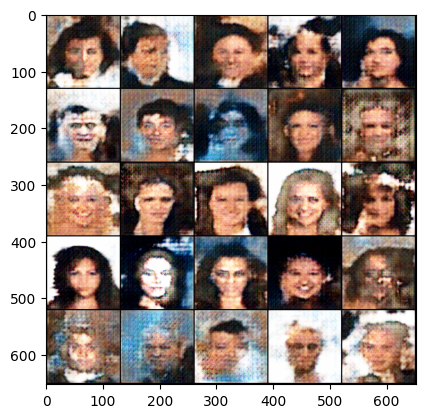

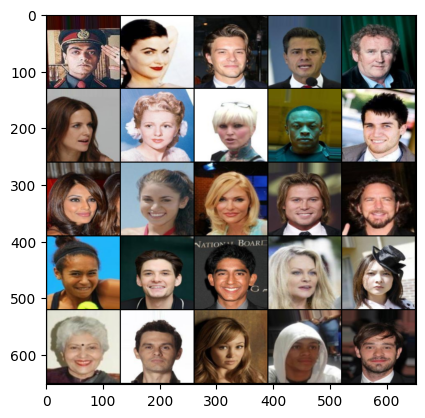

Epoch: 16: Step 1280: Generator loss: 20.85860958099365, critic loss: -7.283044911623006


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1360 80
Saved checkpoint


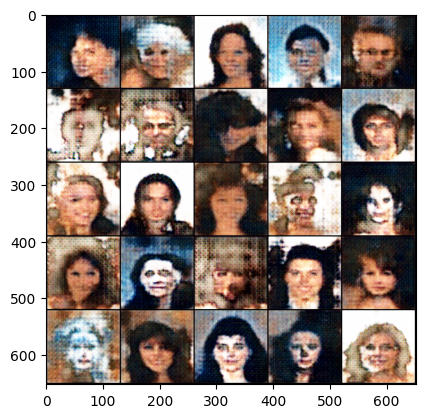

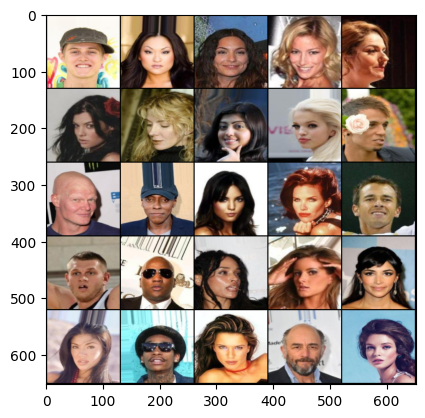

Epoch: 17: Step 1360: Generator loss: 21.21244970560074, critic loss: -7.2688670361042025


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1440 80
Saved checkpoint


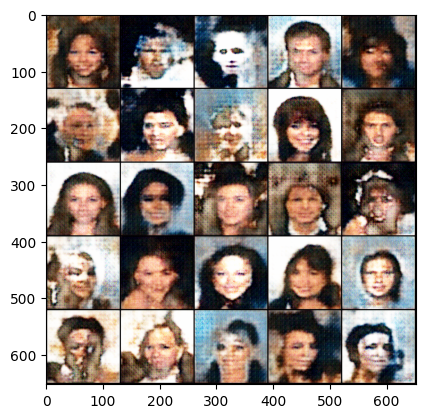

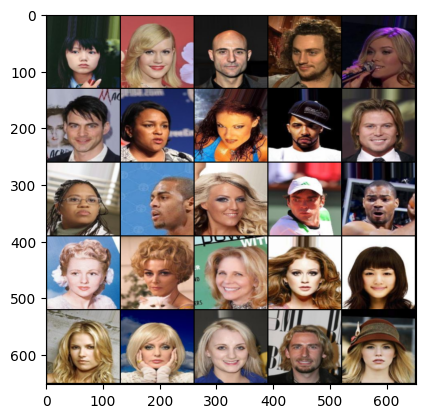

Epoch: 18: Step 1440: Generator loss: 21.069197559356688, critic loss: -7.303447042703628


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1520 80
Saved checkpoint


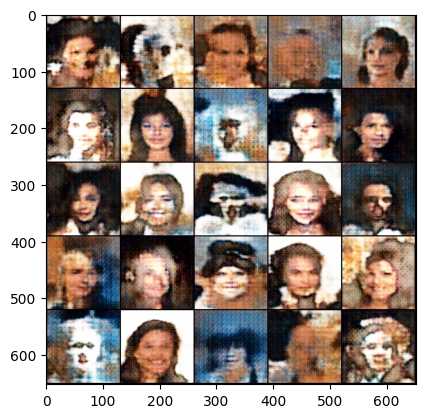

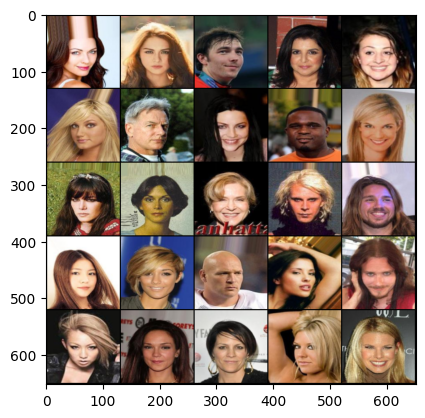

Epoch: 19: Step 1520: Generator loss: 21.266201996803282, critic loss: -7.18256792008877


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1600 80
Saved checkpoint


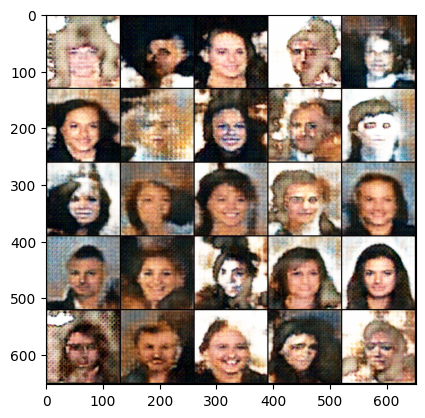

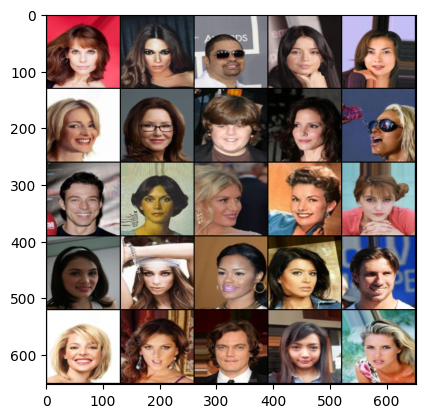

Epoch: 20: Step 1600: Generator loss: 21.688096272945405, critic loss: -7.051383879184724


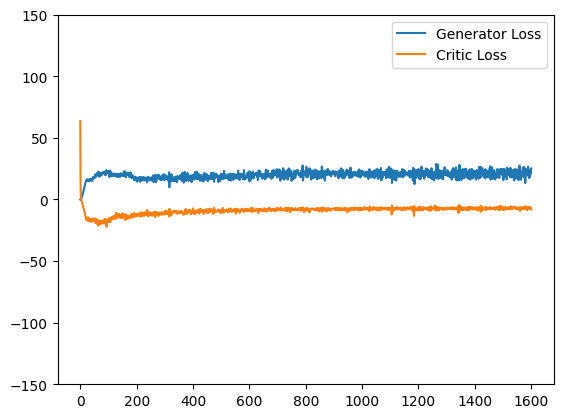

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1680 80
Saved checkpoint


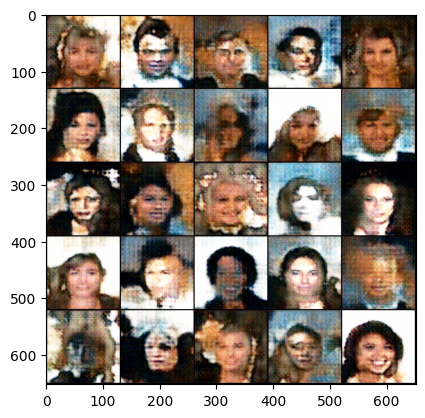

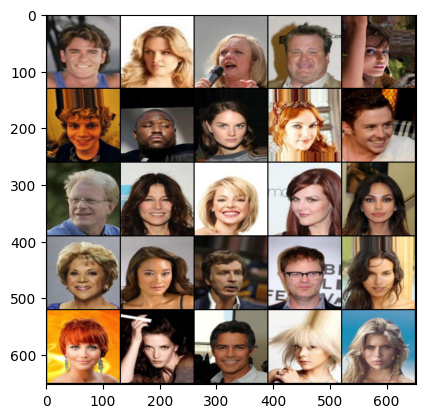

Epoch: 21: Step 1680: Generator loss: 21.53578790426254, critic loss: -6.983478892445566


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1760 80
Saved checkpoint


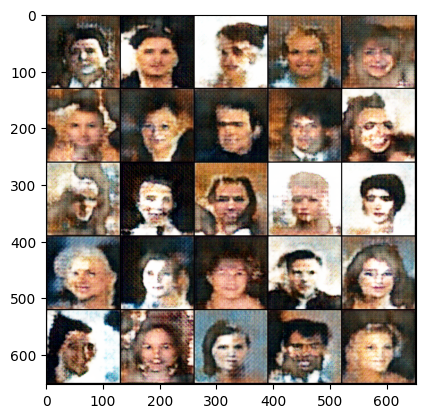

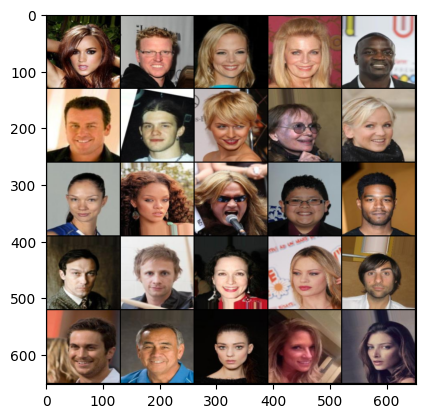

Epoch: 22: Step 1760: Generator loss: 21.70102503299713, critic loss: -6.994956273436548


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1840 80
Saved checkpoint


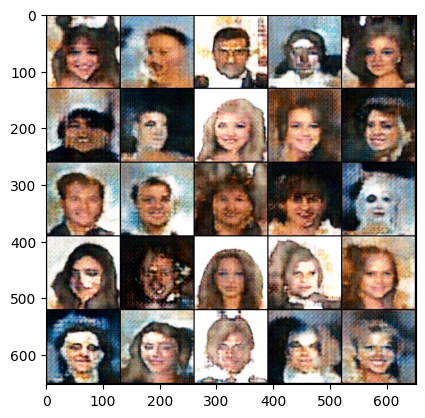

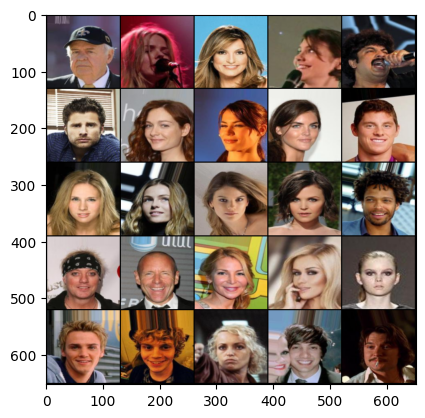

Epoch: 23: Step 1840: Generator loss: 21.50395028591156, critic loss: -6.837116077542303


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1920 80
Saved checkpoint


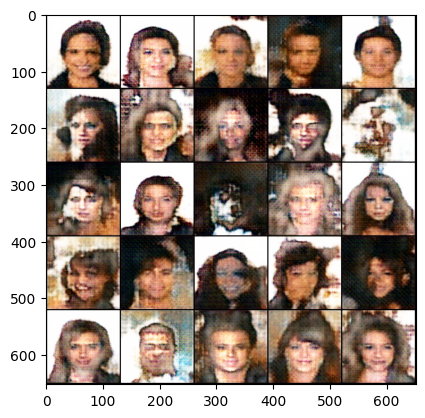

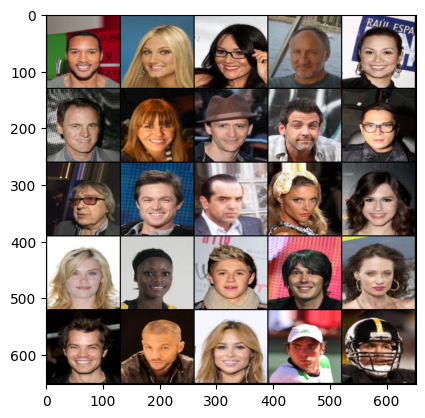

Epoch: 24: Step 1920: Generator loss: 22.00542743206024, critic loss: -6.80116794973612


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2000 80
Saved checkpoint


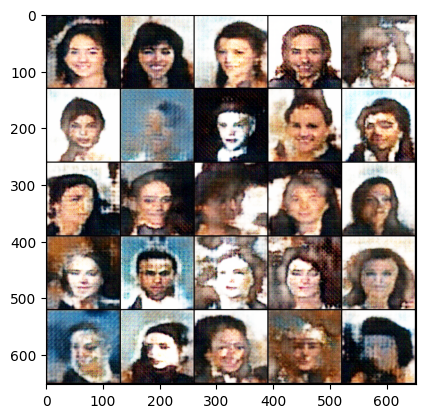

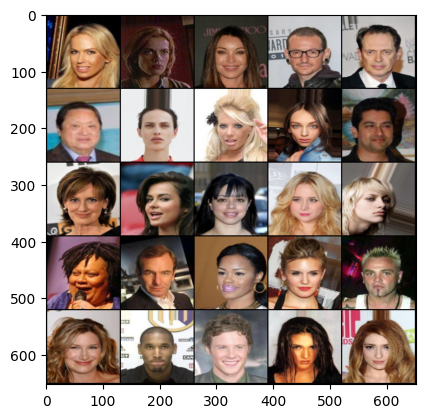

Epoch: 25: Step 2000: Generator loss: 21.35728735923767, critic loss: -6.743763129711152


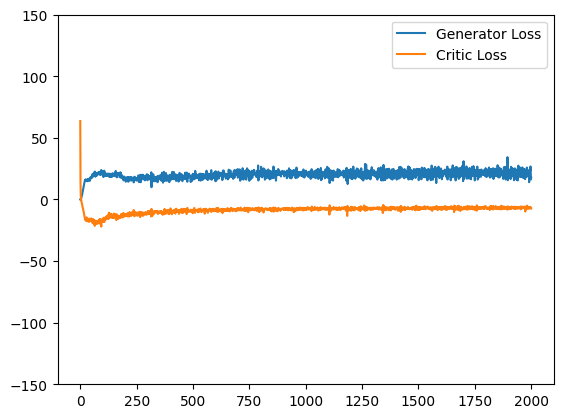

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2080 80
Saved checkpoint


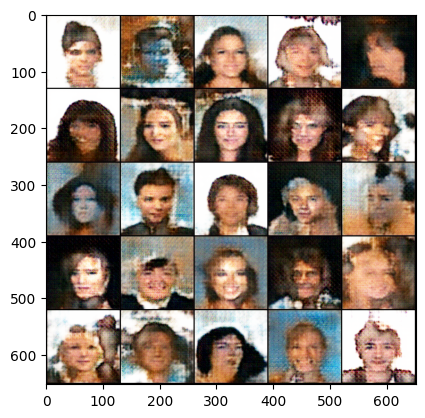

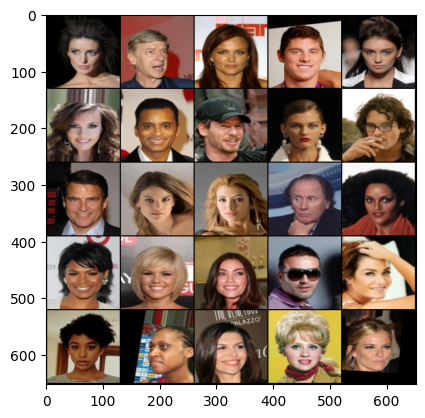

Epoch: 26: Step 2080: Generator loss: 21.38779138326645, critic loss: -6.614328238964083


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2160 80
Saved checkpoint


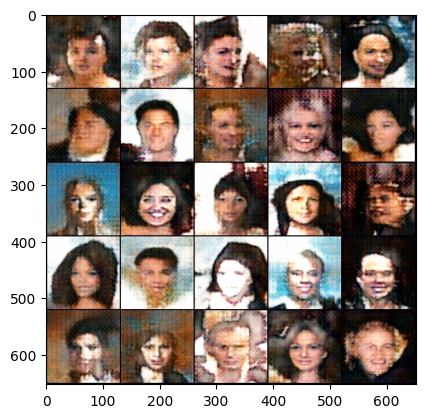

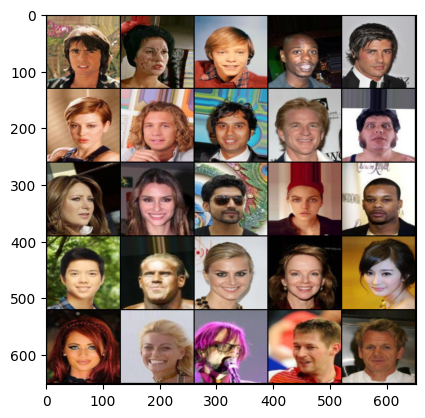

Epoch: 27: Step 2160: Generator loss: 21.48567351102829, critic loss: -6.546021810770033


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2240 80
Saved checkpoint


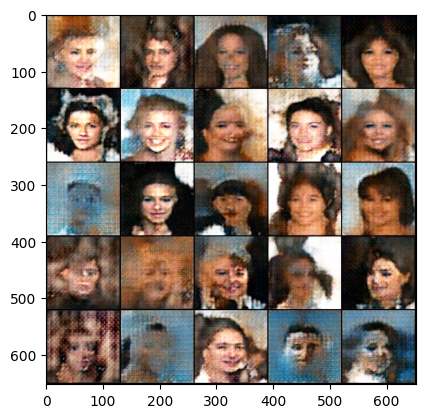

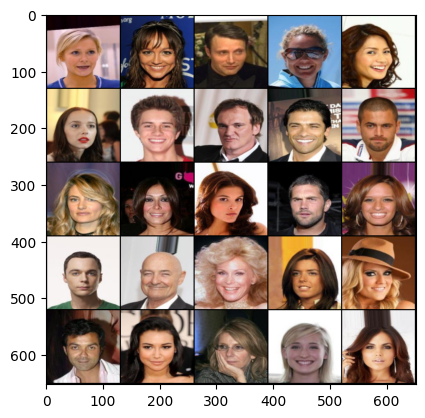

Epoch: 28: Step 2240: Generator loss: 21.25376887321472, critic loss: -6.604254576563838


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2320 80
Saved checkpoint


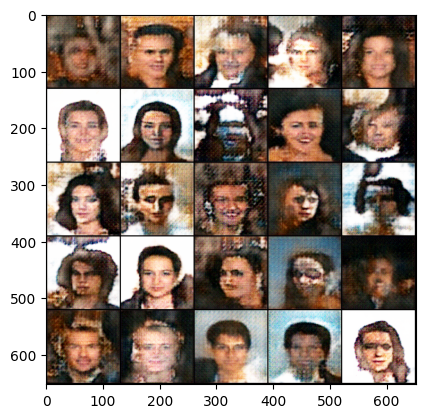

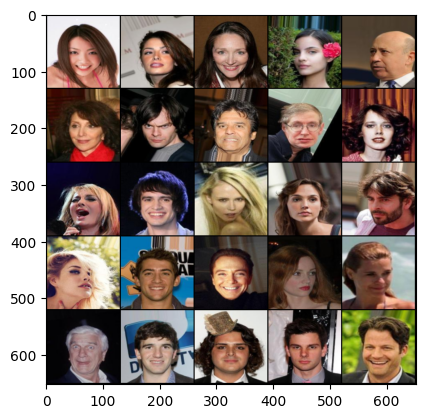

Epoch: 29: Step 2320: Generator loss: 21.353087735176086, critic loss: -6.517195636034013


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2400 80
Saved checkpoint


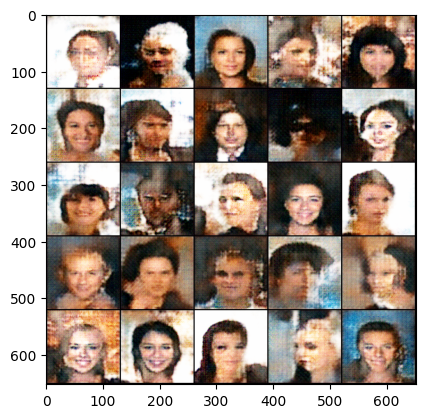

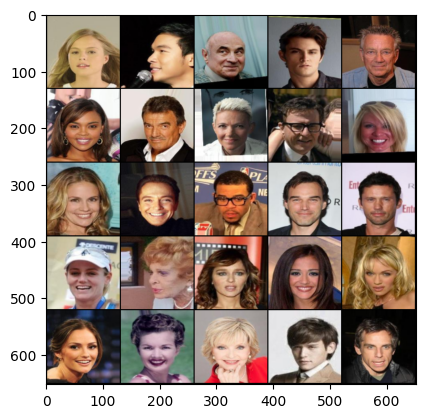

Epoch: 30: Step 2400: Generator loss: 21.06113557815552, critic loss: -6.42143836081028


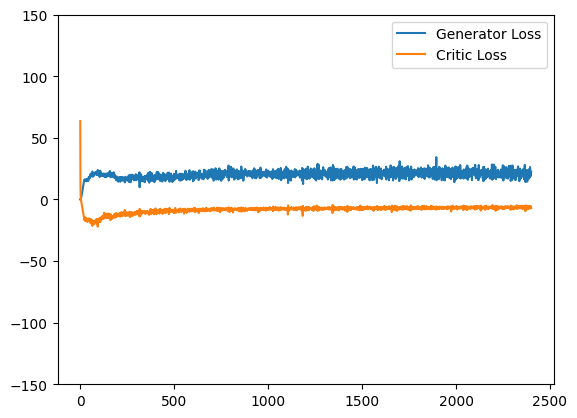

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2480 80
Saved checkpoint


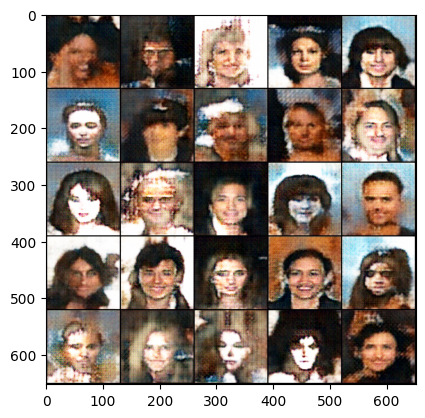

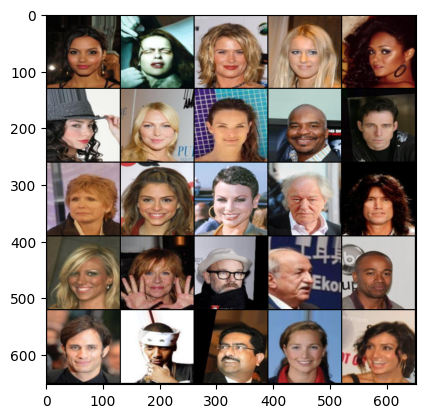

Epoch: 31: Step 2480: Generator loss: 21.1982764005661, critic loss: -6.455274058580398


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2560 80
Saved checkpoint


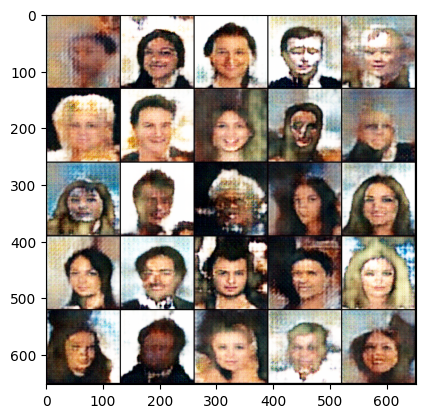

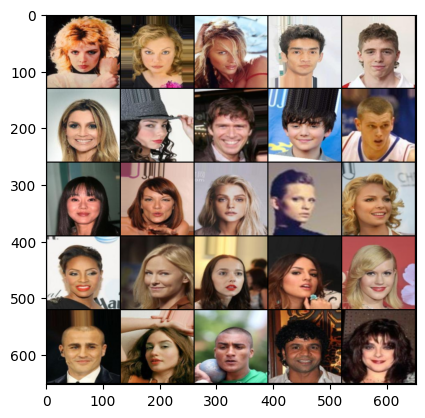

Epoch: 32: Step 2560: Generator loss: 22.021714210510254, critic loss: -6.422182141542436


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2640 80
Saved checkpoint


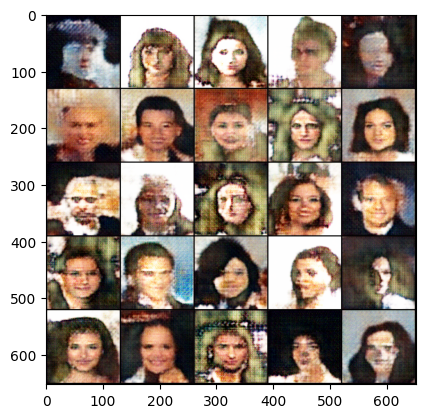

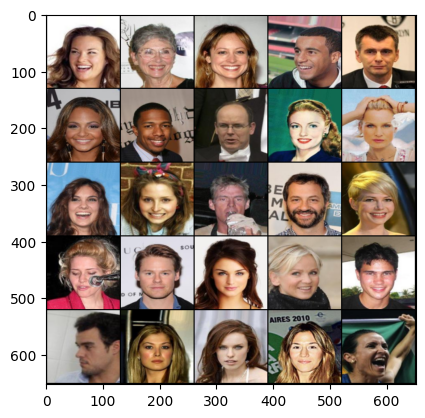

Epoch: 33: Step 2640: Generator loss: 21.683012473583222, critic loss: -6.429504410624503


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2720 80
Saved checkpoint


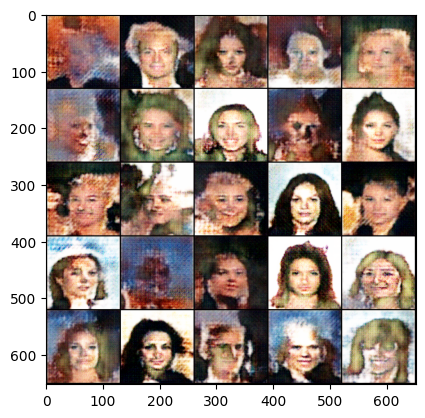

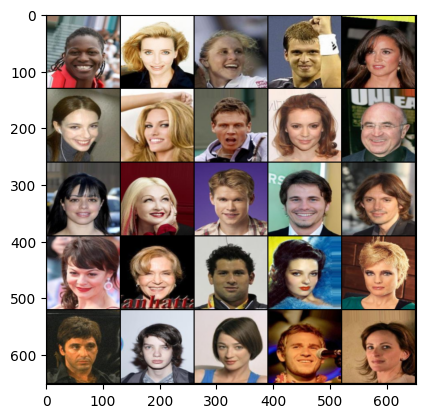

Epoch: 34: Step 2720: Generator loss: 21.099292397499084, critic loss: -6.404827706813812


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2800 80
Saved checkpoint


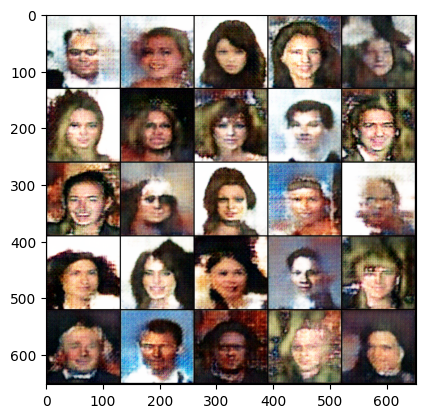

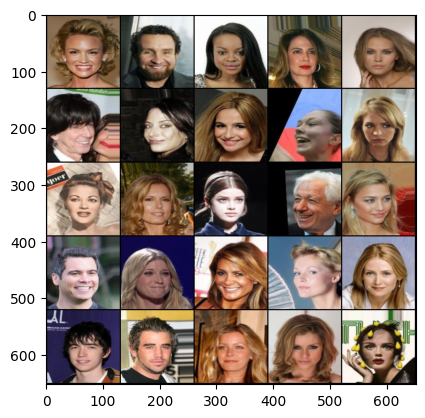

Epoch: 35: Step 2800: Generator loss: 21.008254182338714, critic loss: -6.396994738578796


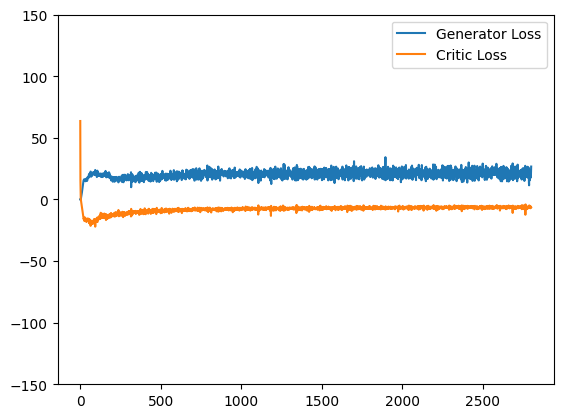

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2880 80
Saved checkpoint


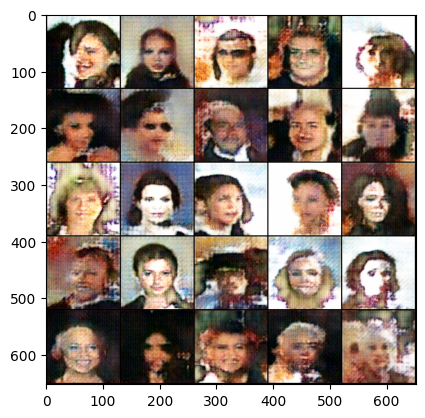

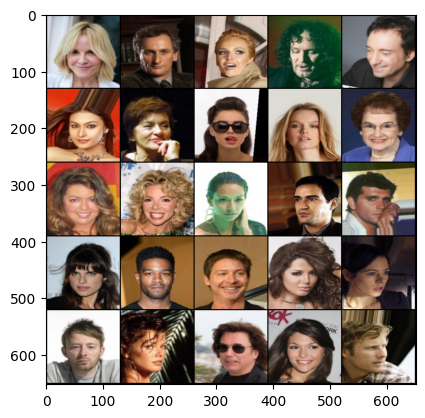

Epoch: 36: Step 2880: Generator loss: 20.92867867946625, critic loss: -6.226676445007326


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  2960 80
Saved checkpoint


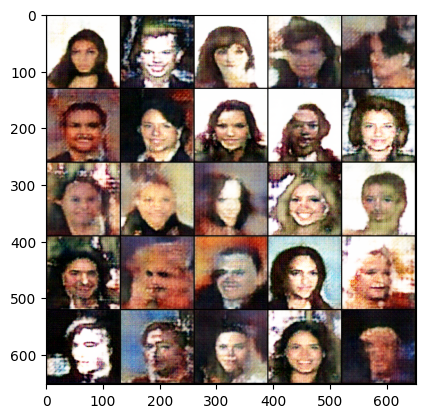

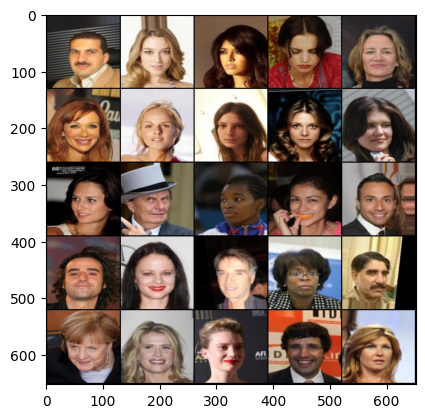

Epoch: 37: Step 2960: Generator loss: 20.787736105918885, critic loss: -6.249504574537277


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  3040 80
Saved checkpoint


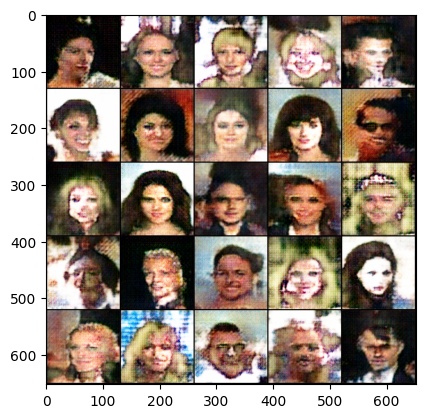

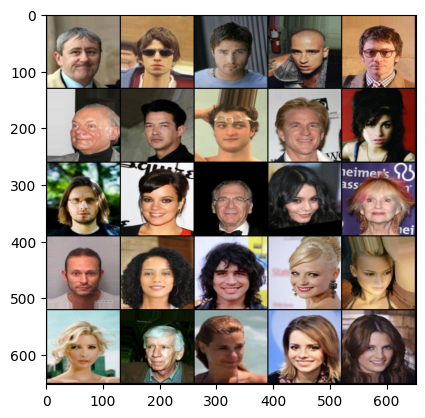

Epoch: 38: Step 3040: Generator loss: 20.56675692796707, critic loss: -6.187210909128189


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  3120 80
Saved checkpoint


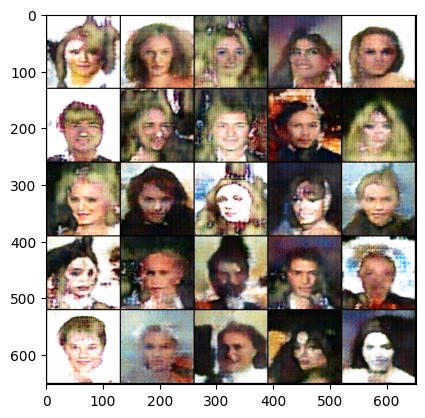

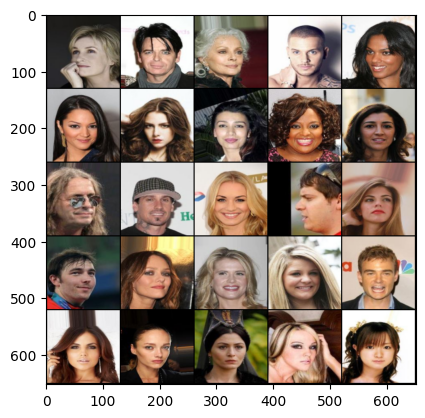

Epoch: 39: Step 3120: Generator loss: 20.219136273860933, critic loss: -6.165666935741902


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  3200 80
Saved checkpoint


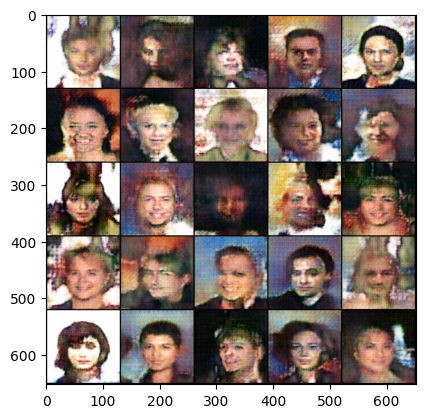

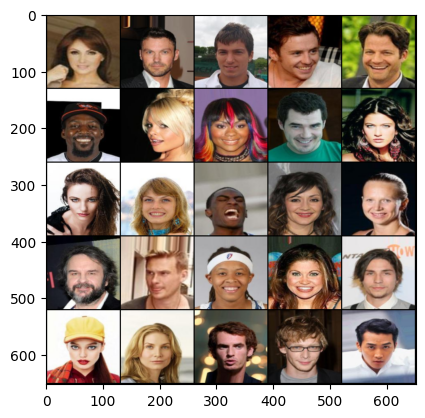

Epoch: 40: Step 3200: Generator loss: 19.554935371875764, critic loss: -6.282126791477202


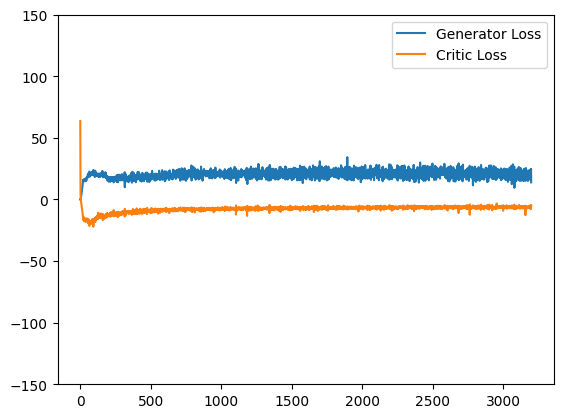

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  3280 80
Saved checkpoint


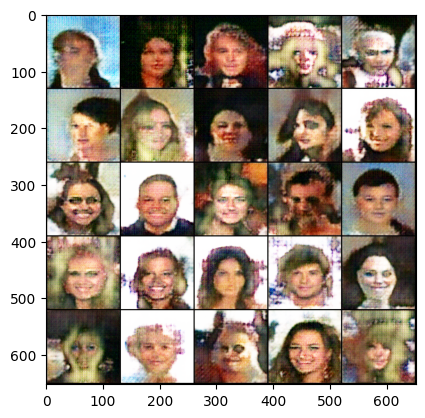

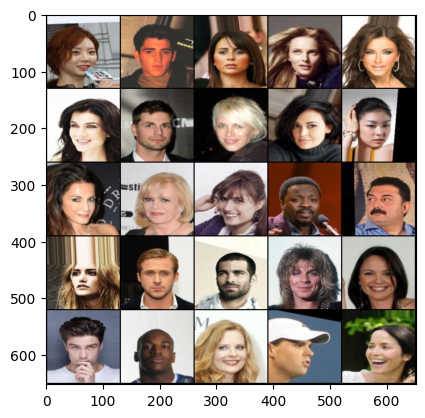

Epoch: 41: Step 3280: Generator loss: 20.39224214553833, critic loss: -6.261985039710998


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  3360 80
Saved checkpoint


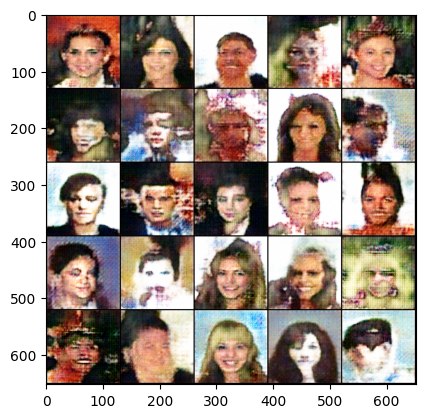

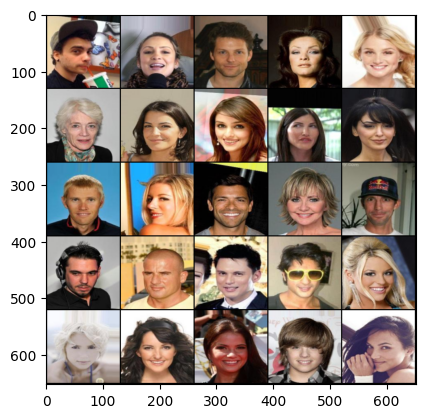

Epoch: 42: Step 3360: Generator loss: 19.639253091812133, critic loss: -6.270110119879247


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  3440 80
Saved checkpoint


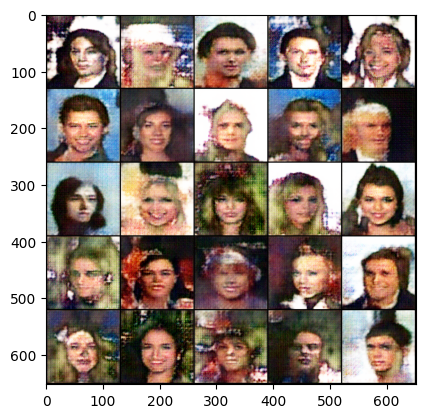

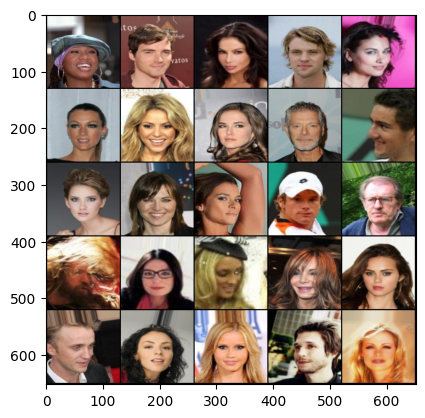

Epoch: 43: Step 3440: Generator loss: 20.475403225421907, critic loss: -6.130010158121584


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  3520 80
Saved checkpoint


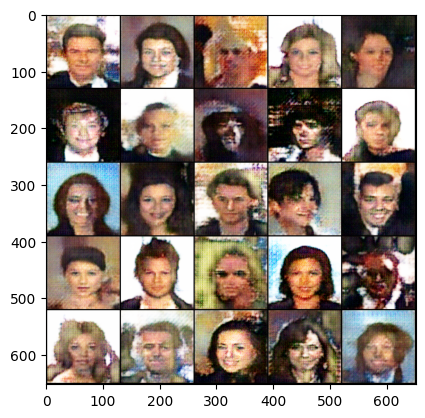

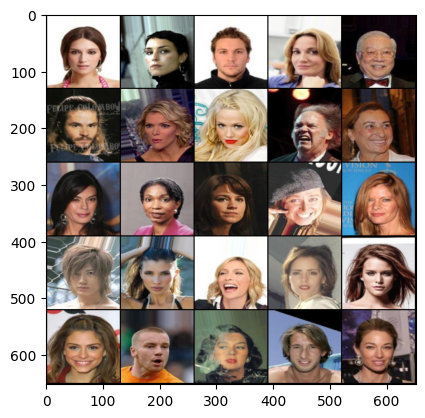

Epoch: 44: Step 3520: Generator loss: 20.29824653863907, critic loss: -6.15451064825058


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  3600 80
Saved checkpoint


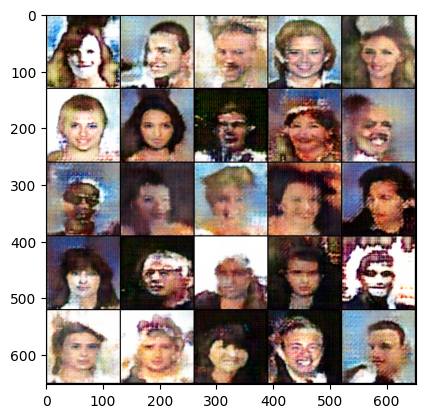

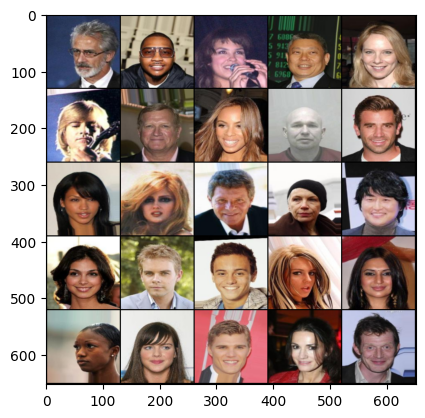

Epoch: 45: Step 3600: Generator loss: 20.154143238067626, critic loss: -6.05301367163658


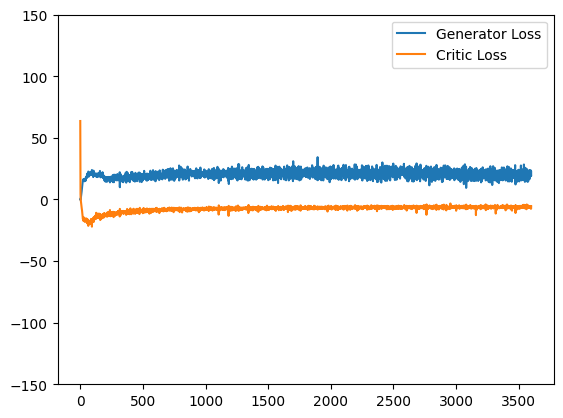

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  3680 80
Saved checkpoint


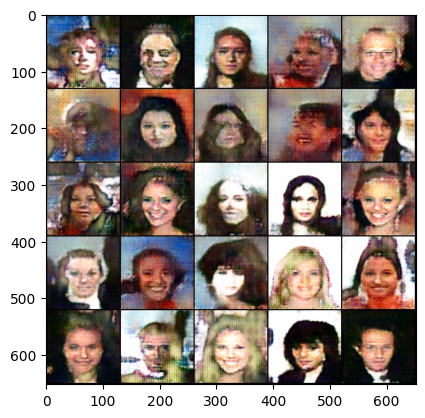

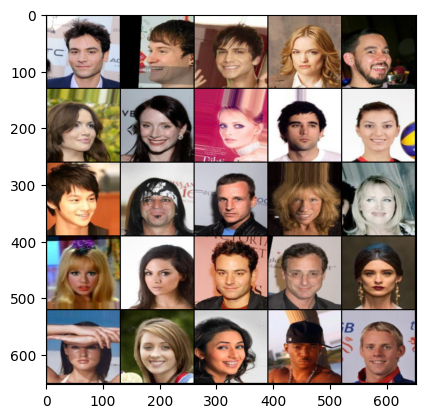

Epoch: 46: Step 3680: Generator loss: 20.029889667034148, critic loss: -6.211467608809469


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  3760 80
Saved checkpoint


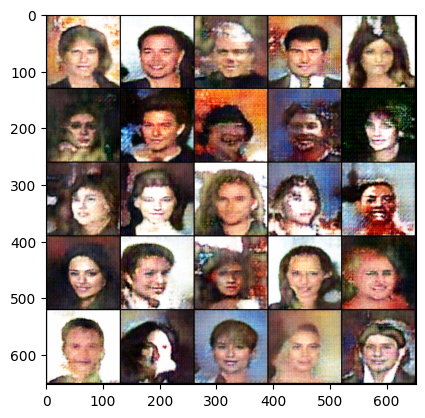

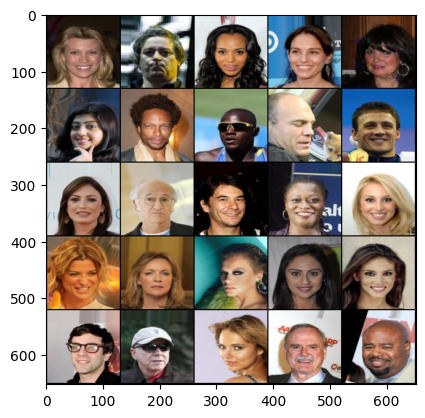

Epoch: 47: Step 3760: Generator loss: 20.289070987701415, critic loss: -6.022061046957972


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  3840 80
Saved checkpoint


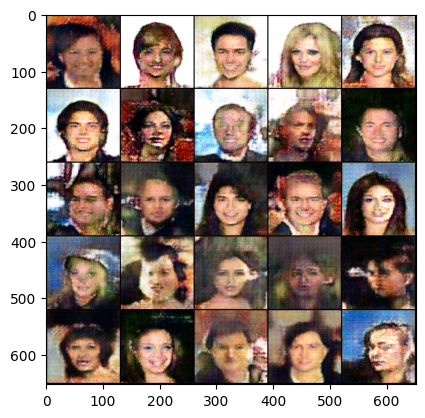

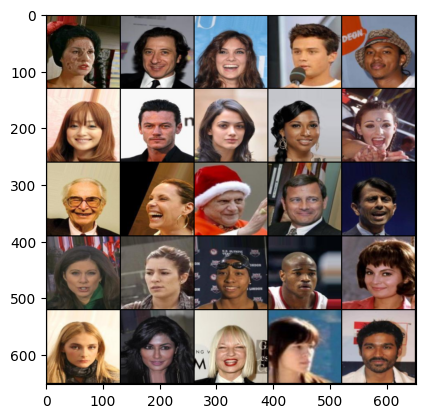

Epoch: 48: Step 3840: Generator loss: 20.338789987564088, critic loss: -6.184705228209498


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  3920 80
Saved checkpoint


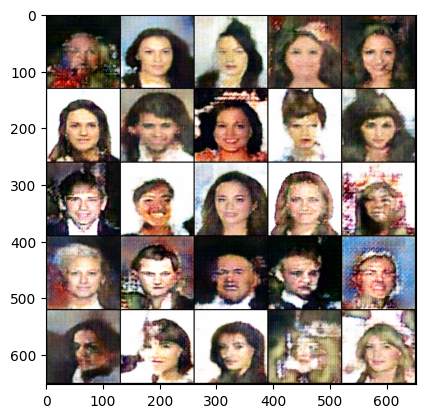

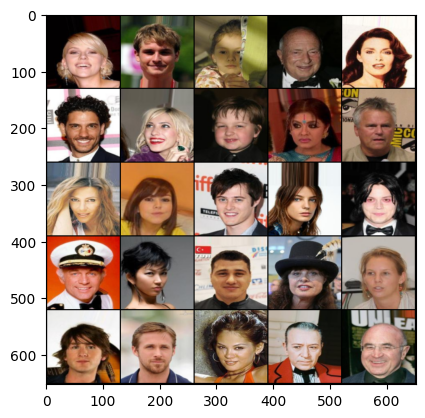

Epoch: 49: Step 3920: Generator loss: 20.60140687227249, critic loss: -6.066494248211383


In [ ]:
## Training loop

for epoch in range(n_epochs):
  for real, _ in tqdm(dataloader):
    cur_bs= len(real) #128
    real=real.to(device)

    ### CRITIC
    mean_crit_loss = 0
    for _ in range(crit_cycles):
      crit_opt.zero_grad()

      noise=gen_noise(cur_bs, z_dim, device)
      fake = gen(noise)
      crit_fake_pred = crit(fake.detach())
      crit_real_pred = crit(real)

      alpha=torch.rand(len(real),1,1,1,device=device, requires_grad=True) # 128 x 1 x 1 x 1
      gp = get_gp(real, fake.detach(), crit, alpha)

      crit_loss = crit_fake_pred.mean() - crit_real_pred.mean() + gp

      mean_crit_loss+=crit_loss.item() / crit_cycles

      crit_loss.backward(retain_graph=True)
      crit_opt.step()

    crit_losses+=[mean_crit_loss]

    ### GENERATOR
    gen_opt.zero_grad()
    noise = gen_noise(cur_bs, z_dim, device)
    fake = gen(noise)
    crit_fake_pred = crit(fake)

    gen_loss = -crit_fake_pred.mean()
    gen_loss.backward()
    gen_opt.step()

    gen_losses+=[gen_loss.item()]

    ### Stats

    if (wandbact==1):
      wandb.log({'Epoch': epoch, 'Step': cur_step, 'Critic loss':mean_crit_loss, 'Gen loss': gen_loss})

    if cur_step % save_step == 0 and cur_step > 0:
      print("Saving checkpoint: ", cur_step, save_step)
      save_checkpoint(f"epoch{epoch}_step{cur_step}")

    if (cur_step % show_step == 0 and cur_step > 0):
      show(fake, wandbactive=1, name='fake')
      show(real, wandbactive=1, name='real')

      gen_mean=sum(gen_losses[-show_step:]) / show_step
      crit_mean = sum(crit_losses[-show_step:]) / show_step
      print(f"Epoch: {epoch}: Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")

      if (cur_step % (show_step*5) == 0 and cur_step > 0):
        plt.plot(
            range(len(gen_losses)),
            torch.Tensor(gen_losses),
            label="Generator Loss"
        )

        plt.plot(
            range(len(gen_losses)),
            torch.Tensor(crit_losses),
            label="Critic Loss"
        )

        plt.ylim(-150,150)
        plt.legend()
        plt.show()

    cur_step+=1


In [ ]:
# number of steps per epoch
# 10000 / 128 = 78.125
# 50000 / 128 = 390.625

In [ ]:
load_checkpoint("epoch49_step3920")


Loaded checkpoint


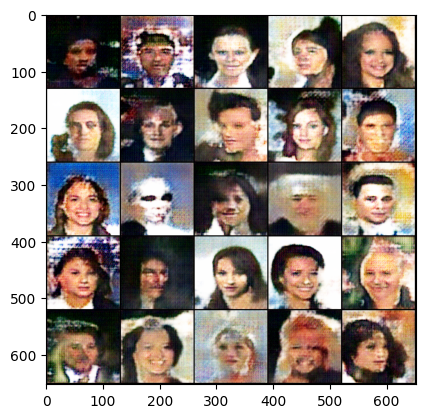

In [ ]:
#### Generate new faces
noise = gen_noise(batch_size, z_dim, device)
fake = gen(noise)
show(fake)

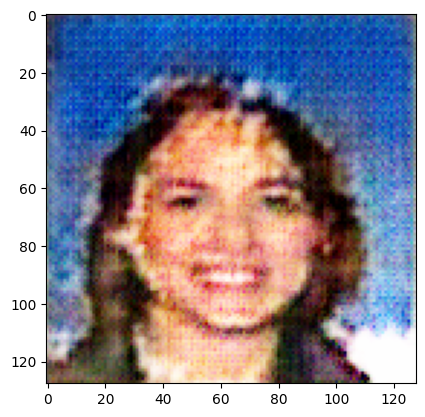

In [ ]:
plt.imshow(fake[10].detach().cpu().permute(1,2,0).squeeze().clip(0,1))

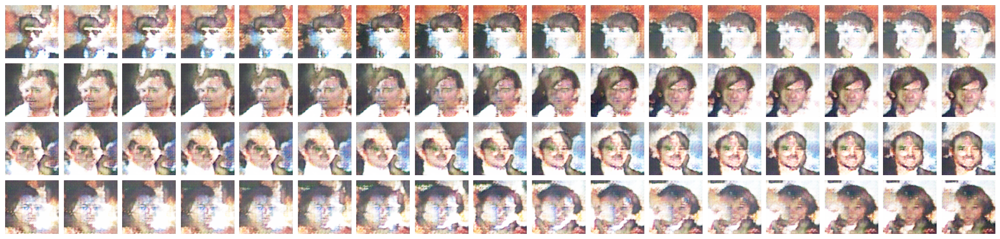

In [ ]:
from mpl_toolkits.axes_grid1 import ImageGrid

# MORPHING, interpolation between points in latent space
gen_set=[]
z_shape=[1,200,1,1]
rows=4
steps=17

for i in range(rows):
  z1,z2 = torch.randn(z_shape), torch.randn(z_shape)
  for alpha in np.linspace(0,1,steps):
    z=alpha*z1 + (1-alpha)*z2
    res=gen(z.cuda())[0]
    gen_set.append(res)

fig = plt.figure(figsize=(25,11))
grid=ImageGrid(fig, 111, nrows_ncols=(rows,steps), axes_pad=0.1)

for ax , img in zip (grid, gen_set):
  ax.axis('off')
  res=img.cpu().detach().permute(1,2,0)
  res=res-res.min()
  res=res/(res.max()-res.min())
  ax.imshow(res.clip(0,1.0))

plt.show()